# <center>🔍 Data Scientist Assessment (Video Engagement Data)</center>

In [ ]:
!pip install plotly seaborn matplotlib xgboost pandas joblib

**Note for Recruiters:**  
All Plotly charts below are embedded as static images so they render immediately in Google Drive.  
If you’d like to explore the origial, interactive versions, simply _comment out_ the next code cell, rerun the notebook, and the figures will be fully interactive.
---

In [2]:
################################################Comment out this l  ###############################################

############################### Force Plotly to Embed Static PNGs ##############################
import plotly.io as pio
pio.renderers.default = 'png'   # switch to 'notebook' or 'iframe' for interactivity
# ────────────────────────────────────────────────────────────────────────────────────

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('../')
import warnings;warnings.filterwarnings('ignore')

## 1. Exploratory Data Analysis (EDA)

### **Load the LMS video engagement data.**

In [3]:
from utils import eda # import helper module

In [4]:
df = eda.load_data(file_path='../data/LMS Video Engagement Data.csv')
display(df)

Data loaded successfully from ../data/LMS Video Engagement Data.csv
Dataset shape: (668471, 6)


,student_id,course_id,course_code,video_title,role,completion_rate_percent
0,1fed547bb417,144,ACC101,ACC101LL_Y1_01_02,Student,100.0
1,add68f45e669,144,ACC101,ACC101LL_Y1_01_02,Student,100.0
2,b4b56e4d11b5,144,ACC101,ACC101LL_Y1_01_02,Student,95.2
3,c5fb34ebdb38,144,ACC101,ACC101LL_Y1_01_02,Student,100.0
4,0d78a078190e,144,ACC101,ACC101LL_Y1_01_02,Student,3.2
...,...,...,...,...,...,...
668466,80cf6a9fd30d,389,SEN203,SEN203_Y2_01_05_A,Student,100.0
668467,7c91c74e02be,389,SEN203,SEN203_Y2_01_05_A,Student,100.0
668468,104b06decfd5,389,SEN203,SEN203_Y2_01_05_A,Student,100.0
668469,0f4bbb5108a8,389,SEN203,SEN203_Y2_01_05_A,Student,10.0


### **Compute the average and median watch duration per video.**

In [5]:
eda.calculate_video_engagement(df)


 Top 5 Average and Median Watch Duration Rates per Video (%):


,avg_completion_rate,median_completion_rate
video_title,,
ECO208LL_Y2_02_12,100.0,100.0
ACC212_Y2_02_01_B,100.0,100.0
ACC217_Y2_01_11_A,100.0,100.0
ECO206_Y2_02_05_A,100.0,100.0
GST222_Y2_01_01,100.0,100.0


,avg_completion_rate,median_completion_rate
video_title,,
ECO208LL_Y2_02_12,100.0,100.0
ACC212_Y2_02_01_B,100.0,100.0
ACC217_Y2_01_11_A,100.0,100.0
ECO206_Y2_02_05_A,100.0,100.0
GST222_Y2_01_01,100.0,100.0
...,...,...
Live Lesson With Google Meet (MIVA-ECO 209) (2024-07-18 13_39 GMT+1),2.2,2.2
ACC216LL_Y2_02_08,1.8,1.8
Eco212 Y2 02 01 B,1.5,1.5


### **Plot the top 10 most-watched videos by total duration by the learners.**

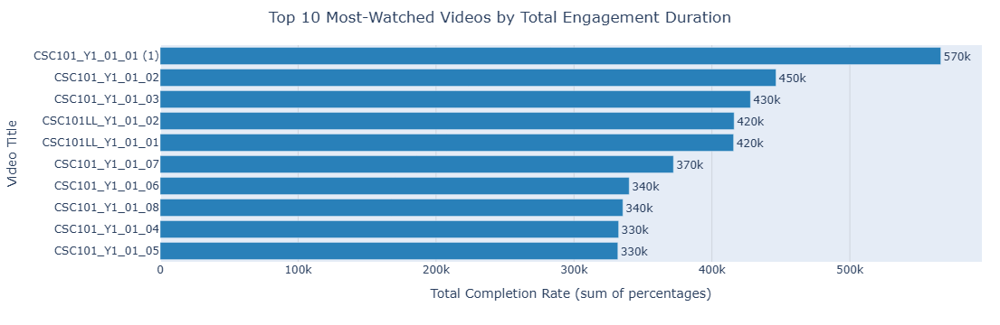

In [6]:
eda.plot_top_videos_by_total_duration(df)

## 2. Learner Engagement Metric

### **Create a function to compute a custom engagement score per learner based on:**
- Completion rate of videos
- Number of unique videos watched

List the top 5 most engaged learners.

In [7]:
from utils import engagement # import helper module

In [8]:
learner_engagement = engagement.calculate_learner_engagement_score(df)

########## Top 5 Most Engaged Learners ##########
print("\nTop 5 Most Engaged Learners:")
display(learner_engagement.head())


Top 5 Most Engaged Learners:


,student_id,engagement_score,avg_completion_rate,unique_videos_watched
2628,8612bd97bd7b,0.967517,97.613653,869
4416,e1ce40511d84,0.967128,94.567967,910
1044,363a743d7b2d,0.955741,98.503582,830
4468,e4eb1c33f5d9,0.950524,99.023086,811
1544,50a41c38d354,0.942899,99.071995,793


## 3. Churn Prediction (Learner’s Completion Threshold)

### **Generate a binary churn label:**
- 1 if the learner has less than 49% completion rate on a video
- 0 otherwise

NB: Build a minimal API (using FastAPI or flask) to expose the endpoint of the model you built.
Optional: deploy this using docker or any cloud service.

In [9]:
from utils import data_processing # import helper module

In [10]:
df_ = data_processing.add_churn_label(df, threshold=49)
print("\nDataFrame with churn label (showing top 5 rows):")
display(df_.head())

print("\nChurn distribution:")
print(df_['churn'].value_counts())

Churn label added (1 if completion < 49%, 0 otherwise).

DataFrame with churn label (showing top 5 rows):


,student_id,course_id,course_code,video_title,role,completion_rate_percent,churn
0,1fed547bb417,144,ACC101,ACC101LL_Y1_01_02,Student,100.0,0
1,add68f45e669,144,ACC101,ACC101LL_Y1_01_02,Student,100.0,0
2,b4b56e4d11b5,144,ACC101,ACC101LL_Y1_01_02,Student,95.2,0
3,c5fb34ebdb38,144,ACC101,ACC101LL_Y1_01_02,Student,100.0,0
4,0d78a078190e,144,ACC101,ACC101LL_Y1_01_02,Student,3.2,1



Churn distribution:
churn
0    521779
1    146692
Name: count, dtype: int64


## 4. Clustering Learners

### **Use any clustering algorithm of your choice to group learners based on:**
- Average video completion
- Number of videos watched

Visualize the clusters and describe them briefly.

In [11]:
from utils import clustering # import helper module

In [12]:
learner_features = clustering.prepare_clustering_data(df.copy())
clustered_learners = clustering.perform_clustering(learner_features.copy())
print("\nClustered Learner Data:")
display(clustered_learners)

print("\nCluster Sizes:")
print(clustered_learners['cluster'].value_counts())

k=2, silhouette score=0.5021
k=3, silhouette score=0.5311
k=4, silhouette score=0.4458
k=5, silhouette score=0.4548
k=6, silhouette score=0.4074
k=7, silhouette score=0.4110
k=8, silhouette score=0.4253
k=9, silhouette score=0.4287
k=10, silhouette score=0.4047
Silhouette analysis plot saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\output\silhouette_scores.png

Optimal number of clusters determined to be : k =  3
Clustering performed with 3 clusters.

Clustered Learner Data:


,avg_completion_rate,unique_videos_watched,cluster
student_id,,,
00198999f778,93.243902,82,2
002f056950f3,58.390000,30,2
0035aa74b150,15.278495,74,1
0045f661762c,88.170000,35,2
006e08a08add,69.635165,173,2
...,...,...,...
ffc83b24aa2c,80.096429,26,2
ffce51c042af,43.677778,14,1
ffe4c4216e0e,100.000000,4,2



Cluster Sizes:
cluster
2    3012
1    1235
0     732
Name: count, dtype: int64


Cluster visualization saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\output\learner_clusters.png

Displaying cluster visualization...


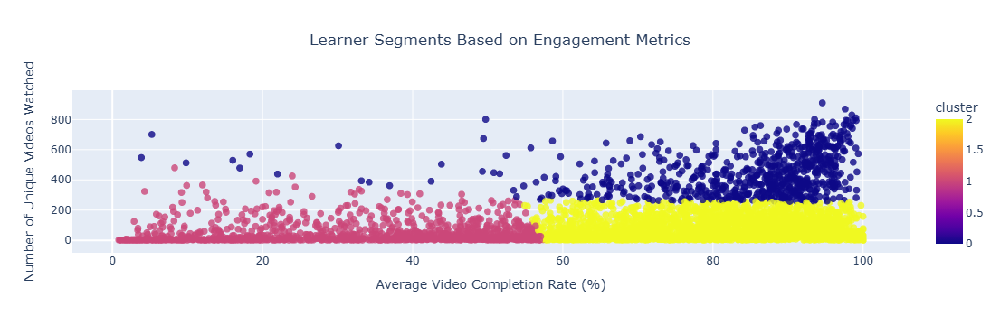


Cluster Characteristics (Averages):


,Avg_Completion,Avg_Unique_Videos,Count
cluster,,,
0,84.454846,450.184426,732
1,32.443903,46.748988,1235
2,81.209714,69.692563,3012


In [13]:
########################## Visualize clusters #########################
cluster_fig = clustering.visualize_clusters(clustered_learners)
print("\nDisplaying cluster visualization...")
cluster_fig.show()

cluster_means = clustered_learners.groupby('cluster').agg(
    Avg_Completion=('avg_completion_rate', 'mean'),
    Avg_Unique_Videos=('unique_videos_watched', 'mean'),
    Count=('avg_completion_rate', 'size')
)
print("\nCluster Characteristics (Averages):")
display(cluster_means)

#### **Interpretation of Clusters Visualization**

**🔵 Cluster 0 (Dark Blue):** <br>

It can be observed that **Cluster 0 (Dark Blue)** learners exhibit the strongest overall engagement: their average completion rates sit between roughly **60% and 100%**, and they have watched anywhere from about **250 up to 800** unique videos. This suggests a cohort that both explores widely and sees nearly every video through to the end. The concentration of points in this cluster appears densest around the 80-95% completion range with 300-600 unique videos watched, indicating these highly engaged learners maintain consistency across large amounts of content.

**🔴 Cluster 1 (Red):** <br>

It can be seen that **Cluster 1 (Red)** learners struggle most with consistency: their completion rates fall between approximately **0% and 60%**, and most have viewed fewer than **300 unique videos** (with a few outliers sampling up to around 500). This pattern points to sporadic or interrupted viewing—ideal candidates for targeted reminders or guided pathways. The highest density of points in this cluster appears at very low completion rates (below 20%) with fewer than 100 videos watched, suggesting many learners who briefly engage but quickly drop off.

**🟡 Cluster 2 (Yellow):** <br>
It is noted that **Cluster 2 (Yellow)** learners strike a middle ground: while their completion rates are high—generally **60% to 100%**—they limit themselves to under **250 unique videos**. In other words, these learners are very thorough in what they watch but are selective about which videos they engage with. The cluster forms a distinctive band across the bottom portion of the high-completion area, with most points concentrated between 80-100% completion rates and 50-200 unique videos, indicating focused learners who complete specific content tracks.

## 5. Anomaly Detection

### **Identify anomalous behavior:**
- Learners who do not watch all course videos between 40% - 50%

In [14]:
from utils import anomaly_detection # import helper module

In [15]:
print("\nAnomaly Detection")
anomalous_learners = (anomaly_detection.find_anomalous_learners(
    df=df,
    min_avg_completion=40,
    max_avg_completion=50
).sort_values(
    by=['avg_completion_rate','unique_videos_watched']
)).reset_index()

print("\nDetected Anomalous Learners: (Learners who do not watch all course videos between 40% - 50%)")
display(anomalous_learners)


Anomaly Detection
Total unique videos in dataset: 4273
Found 276 potential anomalous learners.

Detected Anomalous Learners: (Learners who do not watch all course videos between 40% - 50%)


,index,student_id,avg_completion_rate,unique_videos_watched
0,4141,d3775ebb092e,40.040741,26
1,1027,354669607057,40.056618,115
2,2243,741a14c59200,40.112329,67
3,4206,d6e2643d1967,40.166667,18
4,2403,7c0c514e99cf,40.175258,97
...,...,...,...,...
271,1537,5052420bef0d,49.939655,58
272,4137,d34bdb27154c,49.964706,99
273,4037,cdf783ffff94,49.970000,10
274,2439,7d90e0f48284,49.994093,190


## 6. Learning Path Optimization

### **Based on video interaction, analyze which videos are most often abandoned halfway.**

In [16]:
from utils import path_optimization # import helper module

Found 4209 videos with abandonment at or before 50% completion.


,video_title,abandonment_count
0,CSC101_Y1_01_09,2335
1,CSC101LL_Y1_01_01,1108
2,Live Lesson With Google Meet (CSC 101) (2024-0...,1060
3,CSC101LL_Y1_01_04,967
4,CSC101LL_Y1_01_07,960
...,...,...
4082,ECO216_Y2_01_08,1
4083,BCH202_Y2_01_08_A,1
4084,ACC206LL_Y2_02_13,1
4085,ACC206_Y2_02_01,1


Abandoned videos plot saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\output\abandoned_videos_plot.png


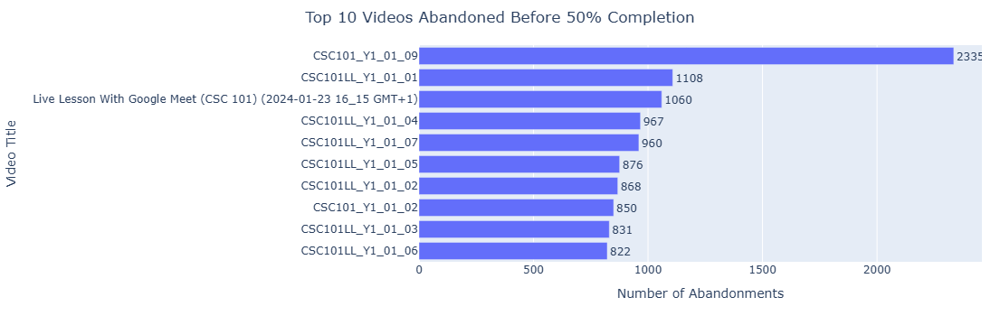

In [18]:
####################### FIND AND PLOT ABANDONED VIDEOS (<=50% completion) #######################

abandoned_videos_df = path_optimization.find_abandoned_videos(
    df=df,
    abandon_rate=50
)
display(abandoned_videos_df)


abandoned_fig = path_optimization.plot_abandoned_videos(
    abandonment_counts=abandoned_videos_df,
    top_n=10
)
abandoned_fig.show()

### **Based on video interaction, analyze if there's a pattern in drop-off e.g due to course.**

,total_views,dropoff_views,dropoff_rate
course_code,,,
ENT123,10,9,0.900000
UST 101,27,24,0.888889
PEACE AND CONFLICT RESOLUTION,7,6,0.857143
PSY102,39,18,0.461538
AMS102,5877,2683,0.456525
CSS108,79,36,0.455696
CSS102,134,55,0.410448
BUA218,485,199,0.410309
PHS203,1136,466,0.410211


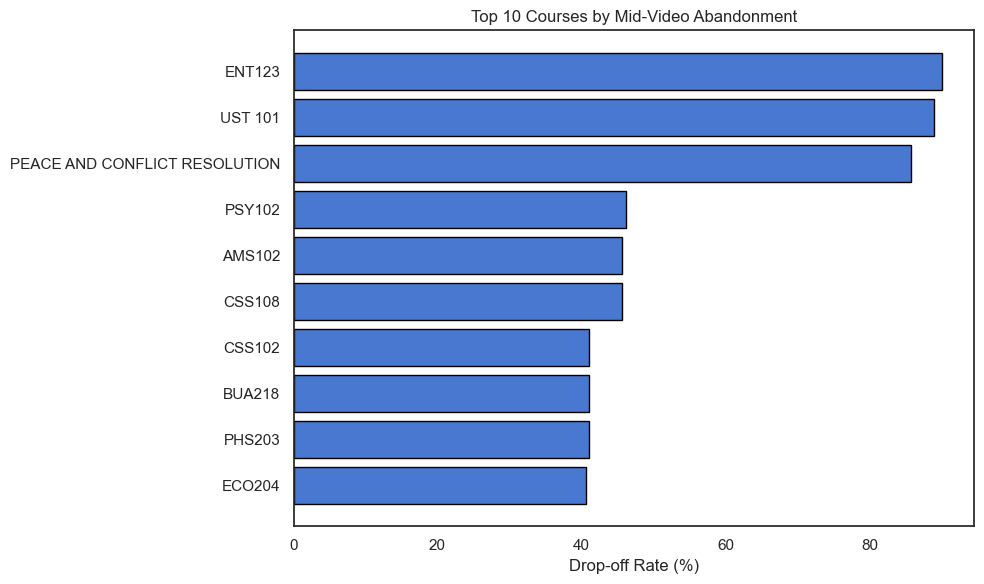

In [20]:
############################ ANALYZE DROP-OFF PATTERNS ###############################

course_stats = df.groupby('course_code').agg(
    total_views=('completion_rate_percent', 'count'),
    dropoff_views=('completion_rate_percent', lambda x: (x < 50).sum())
)
course_stats['dropoff_rate'] = course_stats['dropoff_views'] / course_stats['total_views']
course_stats = course_stats.sort_values('dropoff_rate', ascending=False)

top10 = course_stats.head(10)
display(top10[['total_views','dropoff_views','dropoff_rate']])


############################ PLOT DROP-OFF PATTERNS ###############################
import matplotlib.pyplot as plt
plt.figure(figsize=(10,6))
plt.barh(
    top10.index,
    top10['dropoff_rate'] * 100,
    edgecolor='black'
)
plt.xlabel('Drop-off Rate (%)')
plt.title('Top 10 Courses by Mid-Video Abandonment')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show();

## 7. Predictive Modeling Task

### **Build a model to predict if a Learner will complete a video based on:**
- Past completion rate
- Course

In [21]:
from utils import prediction_xgb # import helper module


Predictive Modeling: Predicting If Learner Will Complete Video?
Engineering New Features...
Feature engineering complete. Shape: (668471, 3)
Target distribution (will_complete) Value Counts:
will_complete
1    485237
0    183234
Name: count, dtype: int64
Starting XGBoost model training...
Train shape: (534776, 2), Test shape: (133695, 2)
Fitting model pipeline...
Evaluating model...

Model Evaluation Results:
Accuracy Score: 0.7939
Recall Score: 0.9401
Precision Score: 0.8075
F1 Score: 0.8688
ROC AUC Score: 0.8064

Classification Report:
              precision    recall  f1-score   support

           0       0.72      0.41      0.52     36647
           1       0.81      0.94      0.87     97048

    accuracy                           0.79    133695
   macro avg       0.76      0.67      0.69    133695
weighted avg       0.78      0.79      0.77    133695


Confusion Matrix:


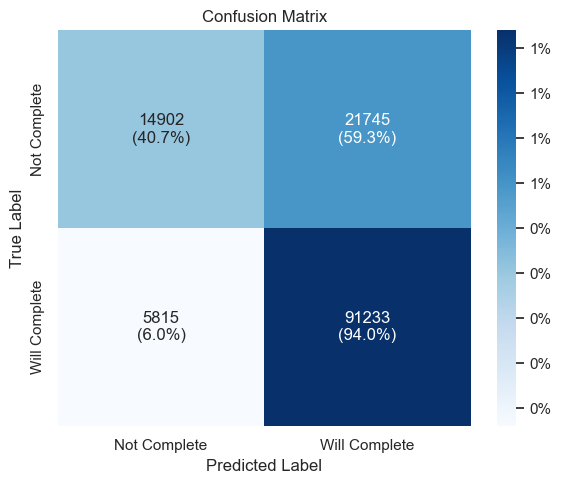

Preprocessor saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\api\models\completion_preprocessor.pkl
Trained model pipeline saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\api\models\completion_predictor.pkl
Feature names saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\api\models\feature_names.txt
Model training and saving complete.

Model training successful. Model artifacts saved in api/models/


In [22]:
print("\nPredictive Modeling: Predicting If Learner Will Complete Video?")

# create new features (feature eng)
features_target_df = prediction_xgb.create_prediction_features(df.copy(), completion_threshold=85)
trained_pipeline, eval_metrics = prediction_xgb.train_completion_model(
    features_target_df,
    model_filename='completion_predictor.pkl',
    preprocessor_filename='completion_preprocessor.pkl'
)

if trained_pipeline:
    print("\nModel training successful. Model artifacts saved in api/models/")
else:
    print("\nModel training failed.")

### **📬 Postman Inference Snapshots**

Below are screenshots demonstrating how the trained XGBoost model was tested using Postman for making predictions via the API.

In [23]:
from IPython.display import display, HTML

paths = [
    "../output/postman/Screenshot 2025-05-01 193241.png",
    "../output/postman/Screenshot 2025-05-01 193358.png",
    "../output/postman/Screenshot 2025-05-01 193717.png",
    "../output/postman/Screenshot 2025-05-01 193813.png",
    "../output/postman/Screenshot 2025-05-01 193921.png",
]

for p in paths:
    display(HTML(f"""
        <div style="text-align: center; margin: 20px 0;">
            <img src="{p}" width="600" height="350" style="border: 1px solid #ccc; border-radius: 8px;">
        </div>
    """))

## 8. Refined Video Struggle Identification (Custom Task)

### **Description:**

This task goes beyond simple abandonment rates to identify specific instances where a learner struggled significantly with a video, defined as achieving a completion rate substantially lower than the average completion rate for that particular video. This helps pinpoint potential learning difficulties or content issues more accurately than a fixed threshold. We will calculate a "struggle score" for each view and identify learners and videos associated with high struggle.

In [24]:
from utils import struggle_analysis # import helper module

In [25]:
struggle_df = struggle_analysis.calculate_video_struggle(df)
struggle_df.head()

Calculating video completion statistics...
Struggle metrics calculated.
Instances of significant struggle (deviation > 1.5 * video_std): 82075


,student_id,course_id,course_code,video_title,role,completion_rate_percent,churn,video_avg_completion,video_std_completion,struggle_deviation,significant_struggle
0,1fed547bb417,144,ACC101,ACC101LL_Y1_01_02,Student,100.0,0,73.346541,37.829407,-26.653459,False
1,add68f45e669,144,ACC101,ACC101LL_Y1_01_02,Student,100.0,0,73.346541,37.829407,-26.653459,False
2,b4b56e4d11b5,144,ACC101,ACC101LL_Y1_01_02,Student,95.2,0,73.346541,37.829407,-21.853459,False
3,c5fb34ebdb38,144,ACC101,ACC101LL_Y1_01_02,Student,100.0,0,73.346541,37.829407,-26.653459,False
4,0d78a078190e,144,ACC101,ACC101LL_Y1_01_02,Student,3.2,1,73.346541,37.829407,70.146541,True



Analyzing Struggle Patterns...

Top Learners by Significant Struggle Count:


,struggle_count,avg_struggle_deviation
student_id,,
c480cbdcfdc9,667,77.146959
2b62e4c8e7bf,441,76.696722
70181a4a6326,427,74.251723
51294ae9a910,423,75.990325
d8149cb53fb5,394,76.516815
69e5828d204a,366,73.528473
030ae289fade,346,73.973447
156ca59b881c,334,71.112330
b089b95b76f8,315,74.629704



Top Videos by Significant Struggle Count:


,struggle_count,avg_struggle_deviation
video_title,,
CSC101LL_Y1_01_01,808,69.443298
CSC101LL_Y1_01_02,750,71.661760
CSC101_Y1_01_02,743,72.933007
CSC101_Y1_01_01 (1),692,71.511235
CSC101LL_Y1_01_03,669,70.170627
CSC101LL_Y1_01_07,616,66.831148
CSC101_Y1_01_07,607,74.634800
CSC101LL_Y1_01_04,605,65.947932
CSC101_Y1_01_06,597,75.341321



Struggle Rate by Course (min views = 100 ):


,total_views,significant_struggles,struggle_rate
course_code,,,
DTS206,208,37,17.79
GST125,11501,1935,16.82
PAD102,2031,328,16.15
GST127,9379,1464,15.61
STA111,16200,2492,15.38
GST121,28895,4352,15.06
MTH203,651,98,15.05
PHY107,14764,2208,14.96
COS101,23027,3435,14.92


Course struggle rate plot saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\output\course_struggle_rate.png
Struggle deviation distribution plot saved to C:\Users\Dell\Desktop\Machine Learning\Miva Open University\src\..\utils\..\output\struggle_deviation_dist.png


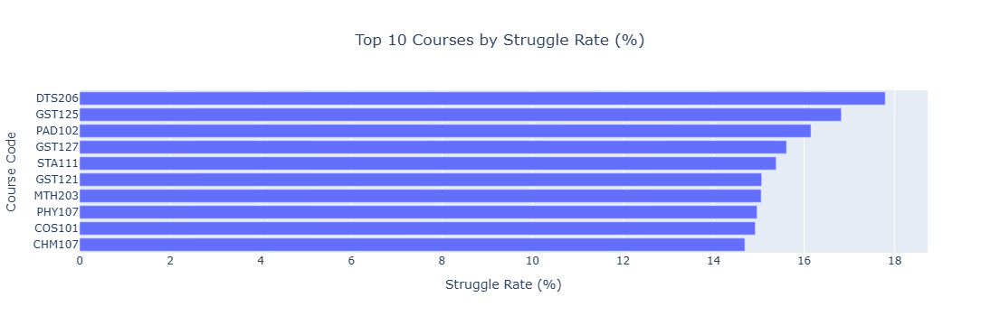

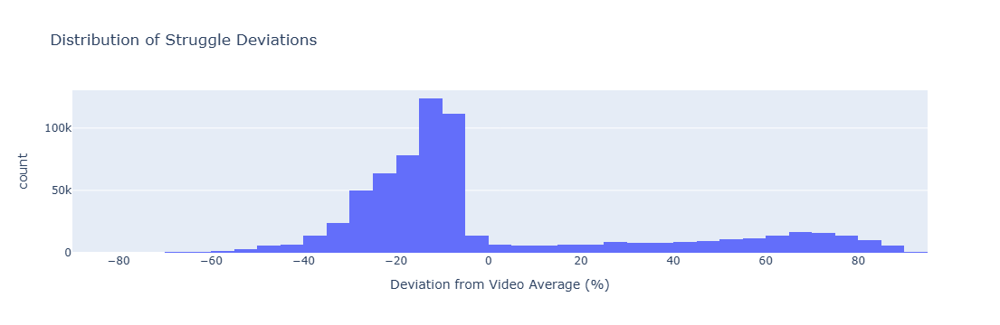

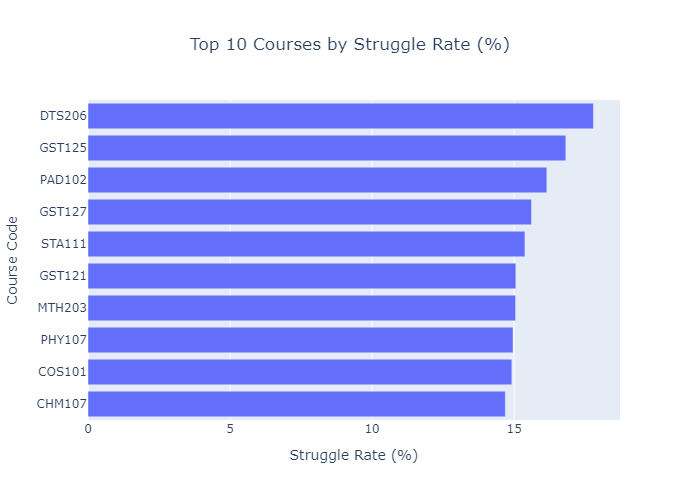

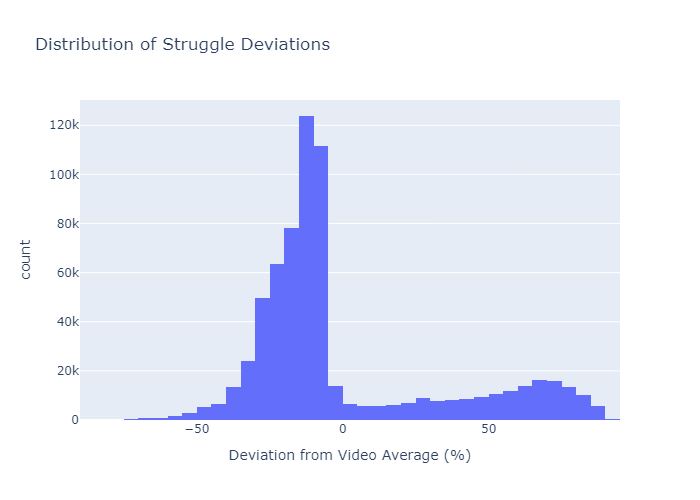

In [22]:
results = struggle_analysis.analyze_struggle_patterns(struggle_df, min_course_views=100)
results['fig_course_struggle'].show()
results['fig_struggle_deviation'].show()